# 0.학번 이름

학번: 20195234

이름: 임지운


* 모든 코드에 주석을 작성해야 점수가 부여됩니다

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D 

# 1. Artificial Data

- Data 는 $x$ 와 $y$ 간 선형관계로 생성했습니다
- Sample의 수는 `total_samples`

- The collection of data is a $X\in \mathbb{R}^\text{total_samples}$ column vector
- The collection of labels is a $y\in \mathbb{R}^\text{total_samples}$ column vector

- 전체 sample들을 training set 과 test set으로 나눠서 저장함
- training set 과 test set은 모두 `numpy array` 자료 구조로 구성함


In [2]:
np.random.seed(4)
total_samples = 100
num_train_samples = 60
num_test_samples = 40

x = np.vstack([(300-50)*np.random.rand(total_samples-10,1)+50, (450-250)*np.random.rand(10,1)+250])

perm = np.random.permutation(total_samples)
x = x[perm]

y = 2.0*x + 10 + np.sqrt(5000)*np.random.randn(total_samples,1)

X_train = x[0:num_train_samples]
X_test = x[num_train_samples+1:-1]
Y_train = y[0:num_train_samples]
Y_test = y[num_train_samples+1:-1]

Text(0, 0.5, 'Price')

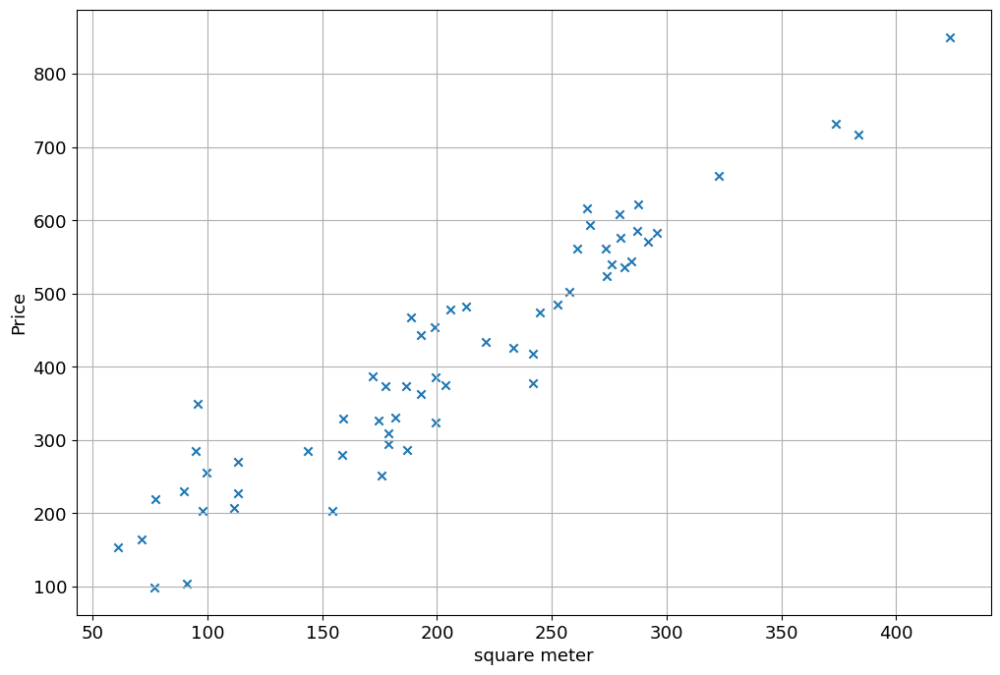

In [3]:
plt.rcParams['font.size'] = 13
plt.rcParams["figure.figsize"] = (12,8)
plt.scatter(X_train, Y_train, marker = 'x')
#plt.scatter(X_test, Y_test, marker = 'o', color = 'red')
plt.grid()
plt.xlabel('square meter')
plt.ylabel('Price')


# 표기 정리

위에서 각 정의된 변수들을 살펴서 수업 표기법과 비교해드립니다. 
`numpy array` `X_train`에 있는 각 원소들은 $x^{(i)}$들을 모아둔 array 입니다. 
예를 들어서 

- $x^{(1)}$ = `X_train[0]`, $x^{(2)}$ = `X_train[1]`
- $y^{(1)}$ = `Y_train[0]`, $y^{(2)}$ = `Y_train[1]`

즉
\begin{align*}
\text{X_train} = \begin{bmatrix}
\text{X_train[0]} \\
\text{X_train[1]}\\
\vdots\\
\text{X_train[m-1]}
\end{bmatrix} = \begin{bmatrix}
(x^{(1)})^T\\
(x^{(2)})^T\\
\vdots\\
(x^{(m)})^T
\end{bmatrix}
\end{align*}

# 2. One-Trick

## Problem 1

수업에서 배웠던 one-trick을 통해서 
\begin{align*}
\tilde X &= \begin{bmatrix}
(\tilde x^{(1)})^T\\
(\tilde x^{(2)})^T\\
\vdots\\
(\tilde x^{(m)})^T
\end{bmatrix}\\
&=\begin{bmatrix}
1 & (x^{(1)})^T\\
1 & (x^{(2)})^T\\
\vdots\\
1 & (x^{(m)})^T
\end{bmatrix}= \begin{bmatrix}
\mathbf{1} & \text{X_train}
\end{bmatrix}
\end{align*}
을 구해보도록 하겠습니다.

- `Xtilde`라는 변수에 $\tilde X$를 저장하세요
- 유용할 수 있는 함수: `np.hstack`, `np.ones`

In [6]:
# 답 작성

Xtilde = np.hstack([np.ones((len(X_train),1)),X_train])
#len(X_train) -> X_train의 행의 길이를 구하는 함수
#np.ones((len(X_train),1)) -> 모든 원소가 1인 행렬을 만드는데 해당 행렬이 R^(len(X_train),1)의 모양이 되도록 만든다.
#위의 모양을 만드는 이유는 모든 원소가 1인 행렬의 행의 길이를 X_train과 맞추기 위해서이다.
#np.hstack([행렬1, 행렬2])을 사용해 두 행렬을 행을 기준으로 합친다.
#위를 전부 종합하여 np.hstack([np.ones((len(X_train),1)),X_train])이 나오고 이는 X_train의 X틸다를 의미한다. 

In [7]:
Xtilde

array([[  1.        , 260.9267485 ],
       [  1.        , 177.56090732],
       [  1.        , 252.53610553],
       [  1.        , 281.68017331],
       [  1.        , 199.31665183],
       [  1.        , 178.68349273],
       [  1.        , 233.14836215],
       [  1.        , 111.36342715],
       [  1.        , 291.75745975],
       [  1.        , 423.15498319],
       [  1.        ,  99.42126865],
       [  1.        , 273.66282308],
       [  1.        ,  95.61135114],
       [  1.        ,  77.04834572],
       [  1.        , 198.92202927],
       [  1.        ,  71.16540276],
       [  1.        ,  77.45452953],
       [  1.        , 279.59575978],
       [  1.        , 212.45127725],
       [  1.        , 295.85016929],
       [  1.        , 244.84573045],
       [  1.        ,  90.96056035],
       [  1.        , 383.38555431],
       [  1.        ,  94.74347751],
       [  1.        , 284.39289599],
       [  1.        , 181.97720585],
       [  1.        , 241.85124177],
 

# 3. Define Model


## Problem 2
As in class, we first choose our model as
\begin{align*}
h(x) = \theta_1 x + \theta_0
\end{align*}
where $\theta = [\theta_0,\, \theta_1]^T$
- `model(x, theta)`를 완성하세요
- x.shape = (num_training_sample, 2) ndarray인 입력을 위해서 설계, 즉, `Xtilde` 가 입력이 되도록 설계
- theta.shape = (2,1) ndarray인 입력을 위해서 설계, 즉, $\theta\in\mathbb{R}^{n+1}$가 입력이 되도록 설계

- 결과가
\begin{align*}
\text{model(Xtilde, theta)} =  \begin{bmatrix}
\theta_1 x^{(1)}+\theta_0 \\
\theta_1 x^{(2)}+\theta_0 \\
\theta_1 x^{(3)}+\theta_0 \\
\vdots\\
\theta_1 x^{(m)}+\theta_0
\end{bmatrix}
\end{align*}
이 되도록 함수를 구성하세요
- 행렬곱으로 구현하세요

In [8]:
def model(x, theta):
    return np.matmul(x, theta)
#이 문제는 굉장히 간단하다.
#그냥 행렬곱을 해버리면 되기 때문이다.
#x는 (60,2)의 Xtlide이고 theta는 (2,1)인 행렬이기 때문에 (60,2) * (2,1) = (60,1) 인 행렬곱이 된다.

예를 들어서 $\theta_1 = 3.0$, $\theta_0 = 8.0$ 일때 $h_\theta(x^{(1)})$은

In [9]:
theta = np.array([[8.0], [3.0]])
model(Xtilde, theta)

array([[ 790.78024549],
       [ 540.68272197],
       [ 765.60831659],
       [ 853.04051993],
       [ 605.94995549],
       [ 544.05047818],
       [ 707.44508644],
       [ 342.09028144],
       [ 883.27237926],
       [1277.46494957],
       [ 306.26380595],
       [ 828.98846924],
       [ 294.83405343],
       [ 239.14503717],
       [ 604.7660878 ],
       [ 221.49620827],
       [ 240.36358859],
       [ 846.78727935],
       [ 645.35383176],
       [ 895.55050788],
       [ 742.53719135],
       [ 280.88168105],
       [1158.15666292],
       [ 292.23043253],
       [ 861.17868796],
       [ 553.93161756],
       [ 733.55372532],
       [ 470.58222851],
       [ 618.92213476],
       [1129.35795599],
       [ 534.8997945 ],
       [ 671.01741134],
       [ 568.42418688],
       [ 191.12004345],
       [ 587.1040777 ],
       [ 485.10998516],
       [ 523.80322936],
       [ 347.73677179],
       [ 976.7319052 ],
       [ 484.0936493 ],
       [ 348.2597365 ],
       [ 847.236

- `model` 함수가 잘 작성되었는지 추가로 확인합시다
- For some random choice $\theta = [8.0, 3.0]^T$ we have the estimates as follows

(-10.0, 450.0)

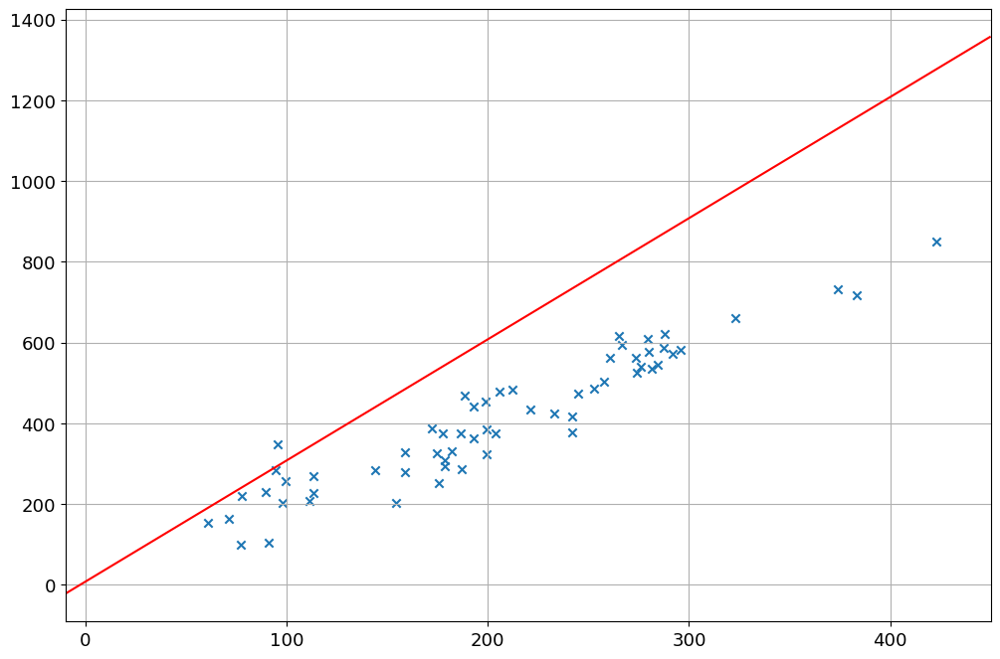

In [10]:
x_arange = np.arange(-10, 450, 0.5).reshape(-1,1)
x_arange_tilde = np.hstack([np.ones((x_arange.shape[0],1)), x_arange])
hx_test_theta_3 = model(x_arange_tilde, theta)
plt.plot(x_arange, hx_test_theta_3, color = 'red')
plt.scatter(X_train, Y_train, marker = 'x')
plt.grid()
plt.xlim([-10, 450])

# 3. Define Cost Function

## Problem 3
`mmse_cost(hx, y)`를 다음과 같이 완성하세요
- $m$을 training data size라고 가정
- input hx는 training sample $x\in\mathbb{R}^m$ 에 대한 $h_\theta(x)\in\mathbb{R}^m$ 값
  - 즉 model(Xtilde, theta)의 출력이라고 생각하고 코딩할 것
- input y는 label $y\in\mathbb{R}^m$
- output
\begin{align*}
\text{output} = \frac{1}{m}\sum_{i=1}^m (h_\theta(x^{(i)})- y^{(i)})^2
\end{align*}

In [11]:
Y_train.shape

(60, 1)

In [12]:
# 답 작성
def mmse_cost(hx, y):
    return sum((hx - y)**2)/len(hx)
#손실함수를 만드는 과정이다
#hx는 (60,1)인 행렬이고 y또한 (60,1)인 행렬이다.
#훈련된 값에서 목표값을 빼애하므로 (hx-y)가 되고 이를 제곱해주면 (hx-y)**2 가 된다.
#(hx-y)**2의 안에 있는 모든 값들을 전부 더해주고 싶으므로 sum()함수를 사용한다.
#sum((hx - y)**2)에서 마지막으로 더한 원소의 수만큼 나눠야하므로 /len(hx)를 사용하여 최종 손실 함수
#sum((hx - y)**2)/len(hx) 가 되는 것이다.

역시 잘 작성되었는지 확인해보도록 합시다.
우선 재미로 $\theta = [8.0,\, 3.0]^T$ 인 모델과 $\theta = [10.0,\, 2.0]^T$ 모델의 크기를 비교해보죠

In [13]:
theta2 = np.array([[10.0],[2.0]])
theta3 = np.array([[8.0],[3.0]])

hx_theta2 = model(Xtilde, theta2)
hx_theta3 = model(Xtilde, theta3)
print('theta = theta2 model loss = ', mmse_cost(hx_theta2, Y_train))
print('theta = theta3 model loss = ', mmse_cost(hx_theta3, Y_train))

theta = theta2 model loss =  [2887.52434543]
theta = theta3 model loss =  [55830.88188107]


# Finding the optimal model via Gradient Descent Algorithm
- 다음 학습은 gradient descent (GD) algorithm을 통해서 최적 모델을 찾도록 하죠
- 우선 loss 함수가 어떻게 생겼는지 한번 보도록 하겠습니다.

In [14]:
def model_grid(x, theta0_grid, theta1_grid):
    hx = []
    for xx in x:
        hx.append(theta1_grid*xx+theta0_grid)
    return np.array(hx)

def mmse_cost_grid(hx, Y_train):
    cost = []
    for i, hhx in enumerate(hx):
        cost.append((hhx-Y_train[i])**2)
    return np.mean(np.array(cost), axis=0)
        

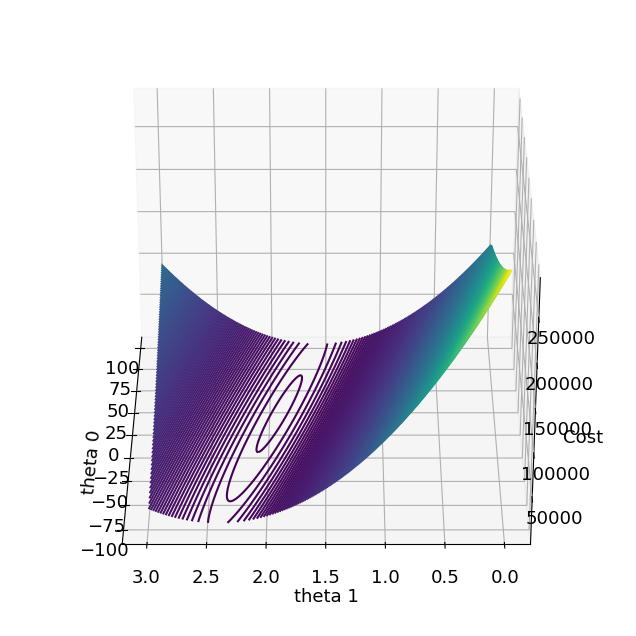

In [15]:
theta1_range = np.arange(0, 3.0, 0.01)
theta0_range = np.arange(-100, 100, 1)


theta1_grid, theta0_grid = np.meshgrid(theta1_range, theta0_range)
loss_grid = mmse_cost_grid(model_grid(X_train, theta0_grid, theta1_grid), Y_train)


fig = plt.figure()
ax = plt.axes(projection='3d')
ax.contour3D(theta0_grid, theta1_grid, loss_grid, 300)
ax.set_xlabel('theta 0')
ax.set_ylabel('theta 1')
ax.set_zlabel('Cost');
ax.view_init(30, 180)

plt.grid()

역시 $\theta$에 대한 2차 함수임을 알수 있죠?
최적 point는 $\theta_0 \approx 18.97$, $\theta_1 \approx 1.9$
임을 볼 수 있습니다.
이제 같은 결과를 GD로 찾아보도록 하죠. 
GD는 다음 한줄이죠?
\begin{align*}
\theta \leftarrow \theta - \alpha \nabla_\theta J(\theta).
\end{align*}

우선 미분 함수를 정의하죠.

## Problem 4
MMSE 함수에 대한 미분함수 `mmse_gradient(theta, x, y)`를 구하세요.
- MMSE 미분함수는 수업에서 
\begin{align*}
\nabla_\theta J(\theta)&= \begin{bmatrix}
\frac{1}{m}\sum_{i=1}^m  2\left( \theta_1 x^{(i)}+\theta_0- y^{(i)}\right)\\
\frac{1}{m}\sum_{i=1}^m  2\left( \theta_1 x^{(i)}+\theta_0- y^{(i)}\right)x^{(i)}\\
\end{bmatrix}\\
&= \frac{1}{m}\sum_{i=1}^m  2\left( \theta_1 x^{(i)}+\theta_0- y^{(i)}\right) \begin{bmatrix}
1 \\
x^{(i)}
\end{bmatrix}\\
&= \frac{1}{m}\sum_{i=1}^m  2\left( \theta_1 x^{(i)}+\theta_0- y^{(i)}\right) \tilde x^{(i)}
\end{align*}
임을 확인했죠?

- input `theta`는 parameter $\theta$
- `x`는 $\tilde X$ (Xtilde)
- `y`는 $y$, 즉 `Y_train`의 입력 자리로 구현

In [18]:
# 답 작성

def mmse_gradient(theta, x, y):
    return 2*np.matmul(Xtilde.T, model(x,theta)-y)/len(x)

#theta_1 * x^(i) + theta_0 부분부터 따로 구해보자.
#이는 문제 2번에서 구했던  model(x, theta)으로 구현할 수 있는 부분이다. 여기에 따로 목표값 y를 빼주면
#model(x,theta)-y 가 되는데 이는 theta_1 * x^(i) + theta_0 - y^(i)이다.
#model(x,theta)-y의 결과는 (60,1)인 행렬이다.
#우리는 위 행렬의 각각의 원소에 x^(i)의 tilde인 [[1],[x^(i)]]를 곱해주고 모든 값의 합을 구하고 싶다.
#이는 Xtilde에 위 행렬 model(x,theta)-y를 행렬 곱하면 된다.
#하지만 Xtilde는 (60,2)인 행렬이고 model(x,theta)-y은 (60,1)인 행렬이니 앞의 Xtilde를 전치행렬로 바꿔 곱해준다.
#위에서 조심할게 있는게 수식에 현혹되어 두개의 곱의 위치를 바꾸면 안된다고 생각할 수 있지만 
#위의 수식은 스칼라 * 벡터 연산이기 때문에 서로의 위치를 바꿔도 된다.
#np.matmul(Xtilde.T, model(x,theta)-y)로 모든 원소들의 합까지 구했다. 남은건 원소의 수만큼 나누고 2를 곱하는 일만 남았다.
#이는 *2와 /len(x)만 붙여주면 끝난다.
#반환해줄 값을 2*np.matmul(Xtilde.T, model(x,theta)-y)/len(x)을 하면 끝이다.

In [19]:
mmse_gradient(theta, Xtilde, Y_train)

array([[   425.30921683],
       [101732.91994596]])

## Problem 5: Implementing GD
이제 GD algorithm을 구현해보죠.
아래 `gradient_descent(x, y, lr, num_epoch)`를 구하도록 하죠.

- input `x`는 `Xtilde`가 들어갈 자리
- input `y`는 `Y_train`이 들어갈 자리
- input `t_init`은 $\theta$ 초기값 
- input `lr`는 learning rate
- input `num_epoch`은 총 반복 횟수입니다

- 연산은
\begin{align*}
\theta &\leftarrow \theta - \alpha \nabla_\theta J(\theta)
\end{align*}
를 구현하세요


- output은 `epoch` 별로 구한 theta vector와 loss 값을 저장하세요.
- theta_list.shape = (2, epoch수) 가되도록 저장하죠
- loss_list.shape = (epoch수) 가 되도록 저장하죠 


In [52]:
def gradient_descent(x, y, t_init, lr, num_epoch):
    # 답작성
    #학습도중 세타값들을 저장해줄 배열과 손실함수를 저장해줄 배열을 선언한다. 근데 
    theta_list = np.array([[],[]])
    loss_list = np.array([])
    #위에서 받은 세타의 초기값을 theta에 넣어준다.
    #왜 일일이 값을 따로 넣고 해당 배열의 타입을 지정해줬냐면 가끔 반복문에서 theta -= lr * mmse함수를 진행할 때
    #int값이 들어가 파이썬이 에러를 일으킬 수 있기 때문이다.
    theta = np.array([[t_init[0][0]],[t_init[1][0]]], dtype=np.float64)
    #입력받은 학습횟수만큼 반복하는 반복문이다.
    for i in range(num_epoch):
        #지금의 세타값을 np.hstack([행렬1],[행렬2])을 통해 행을 기준으로 저장한다.
        theta_list = np.hstack([theta_list,theta])
        #theta값을 통해 현재의 손실함수 값을 구한다. 그리고 배열에 추가한다.
        loss_list = np.append(loss_list, mmse_cost(model(x,theta),y))
        #기울기에 대한 미분함수를 lr만큼 곱하고 현재 theta값에 뺸다. 그리고 그 값을 theta로 지정한다.
        theta -= lr*mmse_gradient(theta, x, y)
    #마지막으로 이제까지 저장한 theta값들의 배열과 loss함수 배열을 반환한다.
    return theta_list, loss_list
        

주의사항) 설명

In [43]:
num_epoch = 10
t_init = np.array([[80],[2]])

theta_list = np.empty((2, num_epoch))
loss_list = np.empty(num_epoch)
theta_list[:,0] = t_init.squeeze()

잘되었는지 확인해보죠
- `t_init`은 일반적으로 랜덤하게 하는것이 좋지만, 우리 숙제 목적상 `theta[0]`은 $[12.0, 3.0]$으로 하겠습니다
- `lr=0.00001`
- `num_epoch = 10`
으로 돌려보죠


In [44]:
num_epoch = 10000
lr = 0.00001
t_init = np.array([[12.0], [3.0]])

ts_gd_array, loss_gd_array = gradient_descent(Xtilde, Y_train, t_init, lr, num_epoch)
ts_gd = ts_gd_array[:,-1].reshape(-1,1)
print('gradient descent theta star = ', ts_gd)

gradient descent theta star =  [[12.18259726]
 [ 1.93910508]]


잘 되었는지 확인을 위해서 다음을 구해보죠.
우리는 GD를 통해서 얻은 $\theta$에서 기울기가 `0` 이기를 바라죠. 어떤 값이 나오는지 확인해보죠

In [45]:
mmse_gradient(ts_gd, Xtilde, Y_train)


array([[-1.84548852],
       [ 0.00776945]])

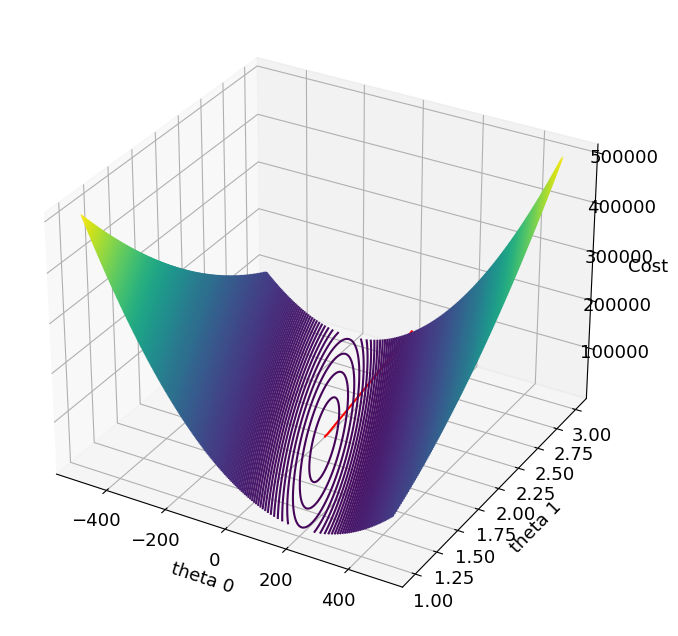

In [46]:
lr = 0.00001
num_epoch = 10
t_init = np.array([[12.0],[3.0]])

theta_gd_array, loss_gd_array = gradient_descent(Xtilde, Y_train, t_init, lr, num_epoch)

#theta_range = np.arange(-20, 20, 0.1)
#loss_range = mmse_cost(model(X_train, theta_range), Y_train)

theta1_range = np.arange(1, 3, 0.01)
theta0_range = np.arange(-500, 500, 1)

theta1_grid, theta0_grid = np.meshgrid(theta1_range, theta0_range)
loss_grid = mmse_cost_grid(model_grid(X_train, theta0_grid, theta1_grid), Y_train)

fig = plt.figure()
ax = plt.axes(projection='3d')
ax.contour3D(theta0_grid, theta1_grid, loss_grid, 300)
ax.set_xlabel('theta 0')
ax.set_ylabel('theta 1')
ax.set_zlabel('Cost');

ax.plot3D(theta_gd_array[0,:], theta_gd_array[1,:], loss_gd_array, color='red')
plt.grid()



# Epoch vs. Loss curve

기계학습에서 중요한 plot 중 하나는 학습 진척도를 epoch 별로 보여주는 epoch vs. Loss curve 입니다.
아래 그리는 방법은 필히 알아두시기 바랍니다.


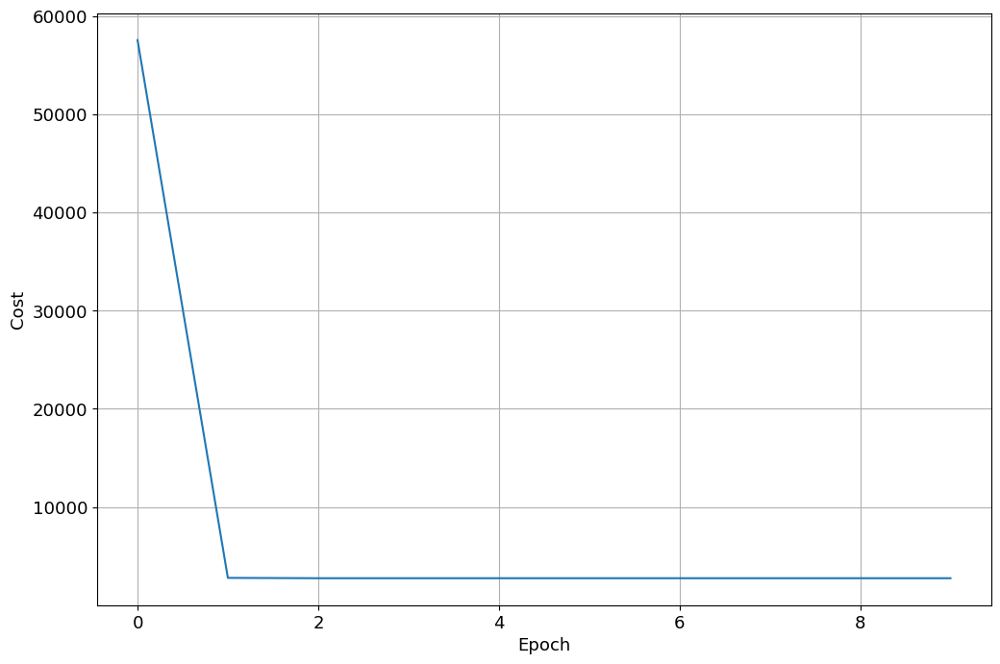

In [47]:

plt.plot(np.arange(0,num_epoch), loss_gd_array)
#plt.semilogy(np.arange(0,num_epoch), loss_gd_array)
plt.xlabel('Epoch')
plt.ylabel('Cost')
plt.grid()

최적 모델의 성능 보기

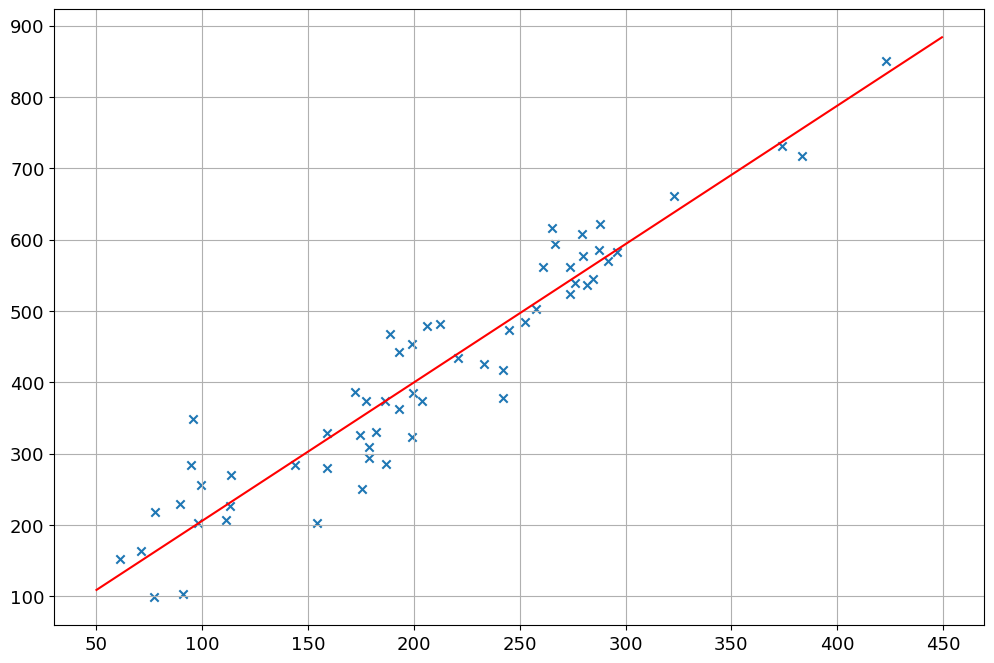

In [48]:
x_arange = np.arange(50, 450, 0.5).reshape(-1,1)
x_arange_tilde = np.hstack([np.ones((x_arange.shape[0],1)), x_arange])

hx_test_theta_3 = model(x_arange_tilde, ts_gd)
plt.plot(x_arange, hx_test_theta_3, color = 'red')
plt.scatter(X_train, Y_train, marker = 'x')
plt.grid()

In [49]:
ts_gd

array([[12.18259726],
       [ 1.93910508]])

Animation으로 진행하는 것을 learning rate을 변화하면서 보도록 하죠

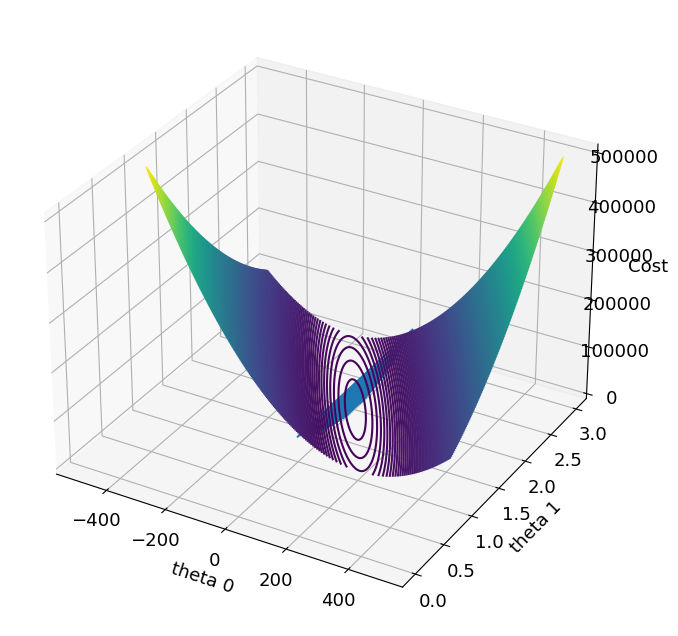

In [50]:
import matplotlib.animation


num_epoch = 40
t_init = np.array([[12],[3]])

#lr = 0.00001
lr = 0.00002
#lr = 0.000001
#lr = 0.000024

#lr = np.array([0.2, 0.00001])
fig = plt.figure()
ax = plt.axes(projection='3d')
#ax.view_init(30, 180)

line, = ax.plot([], [], [])
theta_gd_array, loss_gd_array = gradient_descent(Xtilde, Y_train, t_init, lr, num_epoch)

theta1_range = np.arange(1, 3, 0.01)
theta0_range = np.arange(-500, 500, 1)

theta1_grid, theta0_grid = np.meshgrid(theta1_range, theta0_range)
loss_grid = mmse_cost_grid(model_grid(X_train, theta0_grid, theta1_grid), Y_train)


ax.contour3D(theta0_grid, theta1_grid, loss_grid, 300)
ax.set_xlabel('theta 0')
ax.set_ylabel('theta 1')
ax.set_zlabel('Cost');


def animate(i):
#    line.set_data(theta_gd_array[:,0], theta_gd_array[:,1], loss_gd_array)
    line.set_data(theta_gd_array[0,:i], theta_gd_array[1,:i])
    line.set_3d_properties( loss_gd_array[:i])

ani = matplotlib.animation.FuncAnimation(fig, animate, frames=len(loss_gd_array), interval=400, blit=False)

from IPython.display import HTML
HTML(ani.to_jshtml())

Animation size has reached 21133318 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


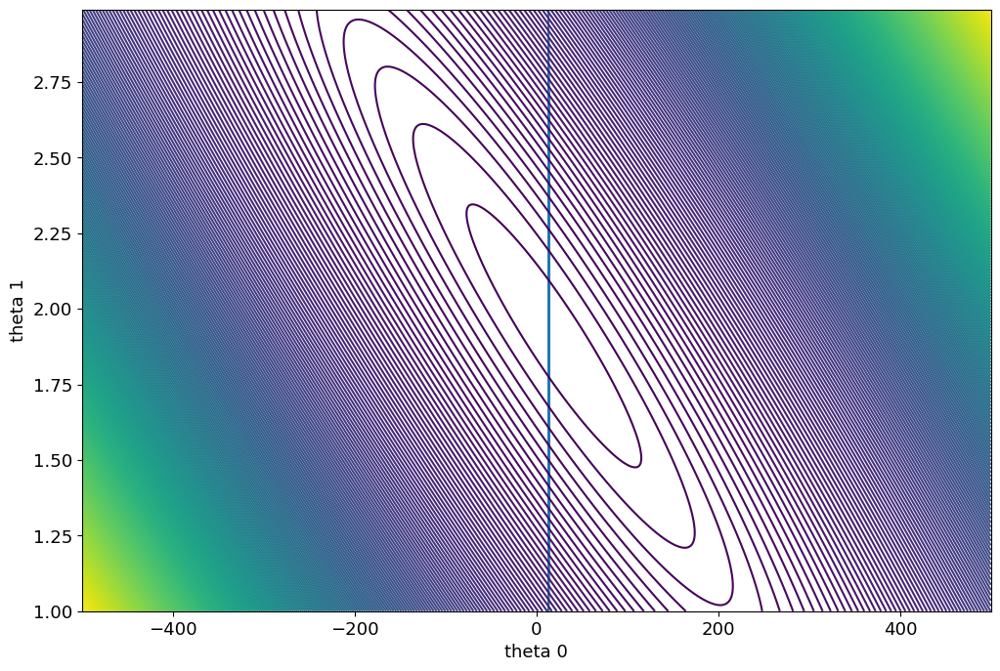

In [51]:
import matplotlib.animation


num_epoch = 40
t_init = np.array([[13],[3]])

#lr = 0.00001
lr = 0.00002
#lr = 0.000001
#lr = 0.000024

#lr = np.array([0.2, 0.00001])
fig, ax= plt.subplots()

line, = ax.plot([], [])
theta_gd_array, loss_gd_array = gradient_descent(Xtilde, Y_train, t_init, lr, num_epoch)

ax.contour(theta0_grid, theta1_grid, loss_grid, 300)
ax.set_xlabel('theta 0')
ax.set_ylabel('theta 1')


def animate(i):
    #line.set_data(theta_gd_array[:,0], theta_gd_array[:,1], loss_gd_array)
    line.set_data(theta_gd_array[0, :i], theta_gd_array[1, :i])

ani = matplotlib.animation.FuncAnimation(fig, animate, frames=len(loss_gd_array), interval=400)

from IPython.display import HTML
HTML(ani.to_jshtml())

# Appendix: Finding the optimal solution analytically
\begin{align*}
\theta^* = (\tilde{X}^T\tilde{X})^{-1}\tilde{X}^T\vec{y}
\end{align*}
where 
\begin{align*}
\tilde{X} = \begin{bmatrix}
\mathbf{1}, X
\end{bmatrix}
\end{align*}

In [53]:
Xtilde = np.hstack([np.ones_like(X_train), X_train])
ts = np.matmul(np.linalg.inv(np.matmul(Xtilde.T, Xtilde)), np.matmul(Xtilde.T, Y_train))

In [54]:
ts

array([[18.97451554],
       [ 1.91051131]])